In [1]:
# Importing open-source libraries

# AWS Client Data Libraries
import boto3
from botocore import UNSIGNED
from botocore.client import Config
from numba import jit
import numba

# Standard Libaries
import os
from pathlib import Path
import soundfile as sf
import json
import datetime
from datetime import datetime, timedelta
from IPython.display import Audio
from tqdm.notebook import trange, tqdm

# Statistics / Analsyis
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import tensorflow as tf
from matplotlib.patches import Rectangle
import scipy
import pandas as pd
import cv2
import librosa
from scipy.signal import find_peaks
import sklearn
from scipy.ndimage import convolve
import scipy

# Custom Helper Functions

#from helper_functions import*

C:\ProgramData\Anaconda3\envs\oceansoundscape2\lib\site-packages\numpy\_distributor_init.py:30: UserWarning: loaded more than 1 DLL from .libs:
C:\ProgramData\Anaconda3\envs\oceansoundscape2\lib\site-packages\numpy\.libs\libopenblas.GK7GX5KEQ4F6UYO3P26ULGBQYHGQO7J4.gfortran-win_amd64.dll
C:\ProgramData\Anaconda3\envs\oceansoundscape2\lib\site-packages\numpy\.libs\libopenblas64__v0.3.21-gcc_10_3_0.dll
  warnings.warn("loaded more than 1 DLL from .libs:"


In [2]:
annotations = r'C:\Users\vikas\OneDrive\Artash_Python\2023 Test\2 - Unk Detection\Annotations'
images_path = r'C:\Users\vikas\OneDrive\Artash_Python\2023 Test\2 - Unk Detection\Dataset\20170718'
image_paths = [os.path.join(images_path, i) for i in os.listdir(images_path)]
CSV_ANN = os.path.join(annotations, os.listdir(annotations)[-1])

In [3]:
annotation_pd = pd.read_csv(CSV_ANN)

In [4]:
annotation_pd

,label_name,bbox_x,bbox_y,bbox_width,bbox_height,image_name,image_width,image_height
0,ROI,73,96,69,46,MARS-20160718T000000Z-16kHz-sample1002.png,540,220
1,ROI,247,103,67,42,MARS-20160718T000000Z-16kHz-sample1005.png,540,220
2,ROI,140,90,68,58,MARS-20160718T000000Z-16kHz-sample1008.png,540,220
3,ROI,489,108,48,48,MARS-20160718T000000Z-16kHz-sample1011.png,540,220
4,ROI,0,87,129,63,MARS-20160718T000000Z-16kHz-sample1014.png,540,220
...,...,...,...,...,...,...,...,...
110,ROI,319,70,108,99,MARS-20160718T000000Z-16kHz-sample933.png,540,220
111,ROI,290,70,99,88,MARS-20160718T000000Z-16kHz-sample936.png,540,220
112,ROI,145,86,107,76,MARS-20160718T000000Z-16kHz-sample939.png,540,220
113,ROI,289,81,97,92,MARS-20160718T000000Z-16kHz-sample939.png,540,220


In [5]:
def get_iou(bb1, bb2):
    assert bb1['x1'] < bb1['x2']
    assert bb1['y1'] < bb1['y2']
    assert bb2['x1'] < bb2['x2']
    assert bb2['y1'] < bb2['y2']
    x_left = max(bb1['x1'], bb2['x1'])
    y_top = max(bb1['y1'], bb2['y1'])
    x_right = min(bb1['x2'], bb2['x2'])
    y_bottom = min(bb1['y2'], bb2['y2'])
    if x_right < x_left or y_bottom < y_top:
        return 0.0
    intersection_area = (x_right - x_left) * (y_bottom - y_top)
    bb1_area = (bb1['x2'] - bb1['x1']) * (bb1['y2'] - bb1['y1'])
    bb2_area = (bb2['x2'] - bb2['x1']) * (bb2['y2'] - bb2['y1'])
    iou = intersection_area / float(bb1_area + bb2_area - intersection_area)
    assert iou >= 0.0
    assert iou <= 1.0
    return iou

In [8]:
im = plt.imread(image_paths[3])

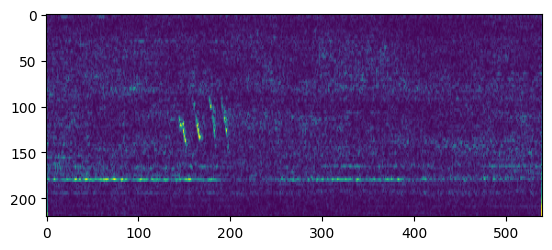

In [9]:
plt.imshow(im)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


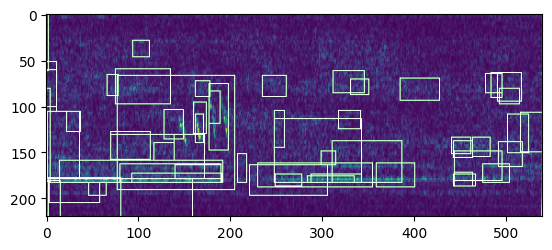

In [10]:
ss = cv2.ximgproc.segmentation.createSelectiveSearchSegmentation()

ss.setBaseImage(im)
ss.switchToSelectiveSearchFast()
rects = ss.process()
imOut = im.copy()
for i, rect in (enumerate(rects[:60])):
    x, y, w, h = rect
#     print(x,y,w,h)
#     imOut = imOut[x:x+w,y:y+h]
    cv2.rectangle(imOut, (x, y), (x+w, y+h), (0, 255, 0), 1, cv2.LINE_AA)
# plt.figure()
plt.imshow(imOut)

In [11]:
filenames = list(set(annotation_pd['image_name']))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


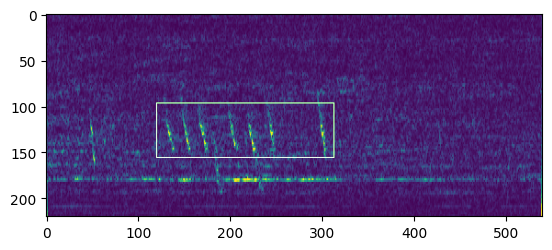

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


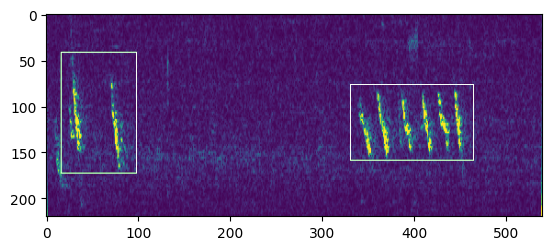

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


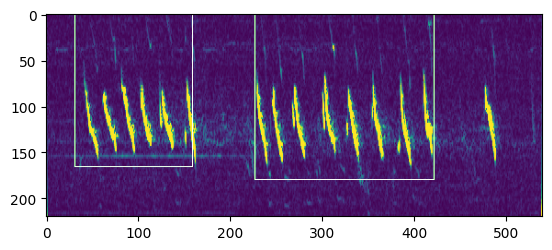

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


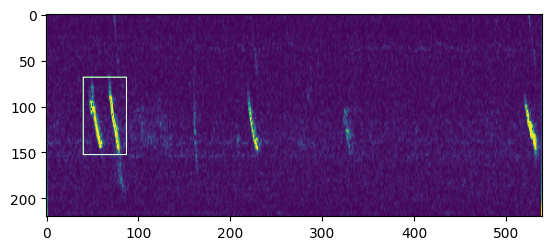

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


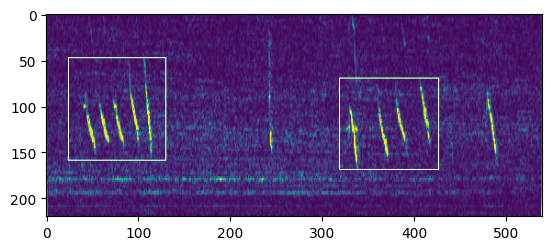

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


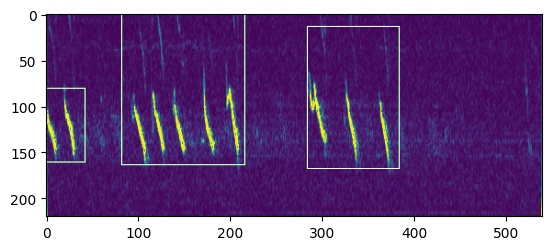

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


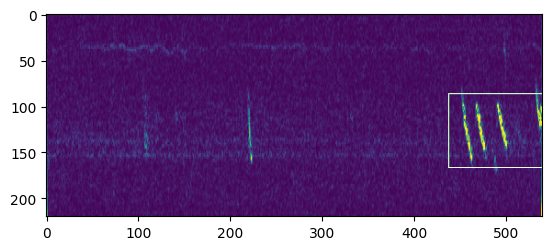

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


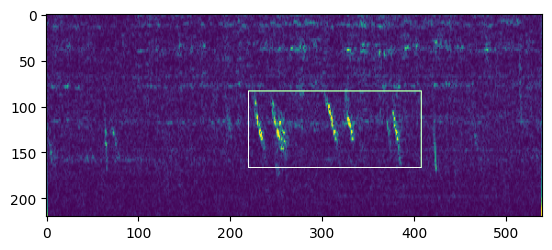

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


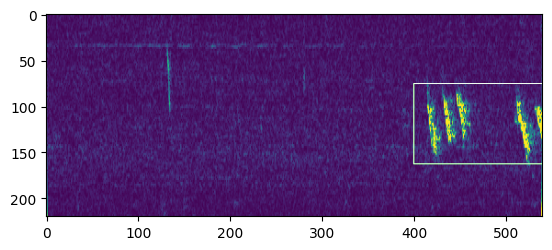

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


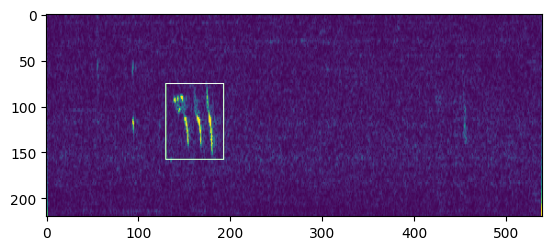

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


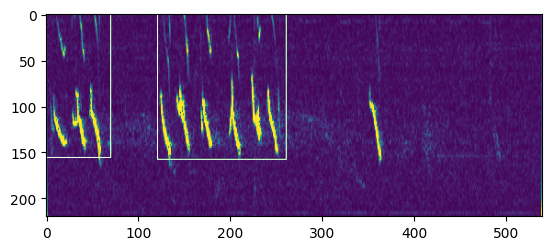

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


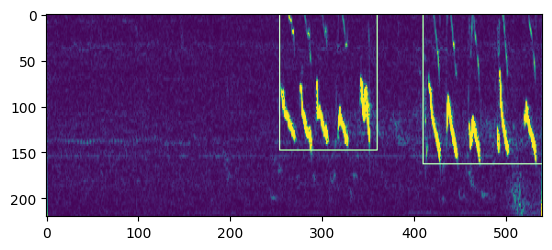

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


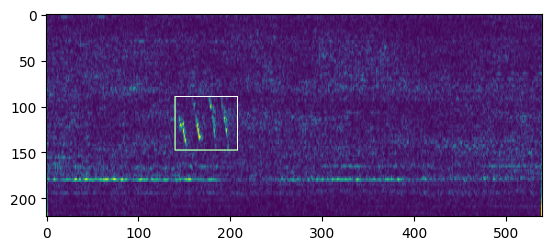

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


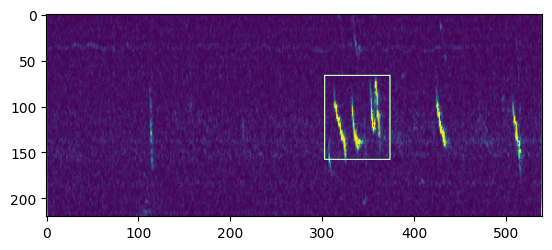

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


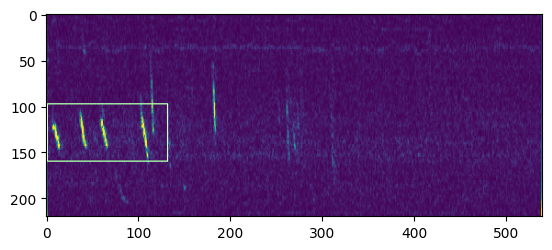

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


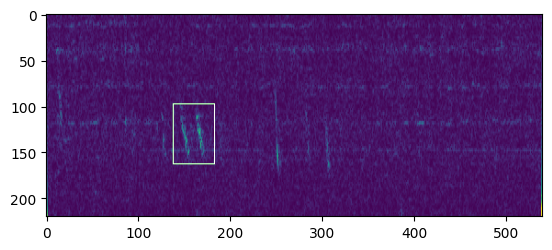

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


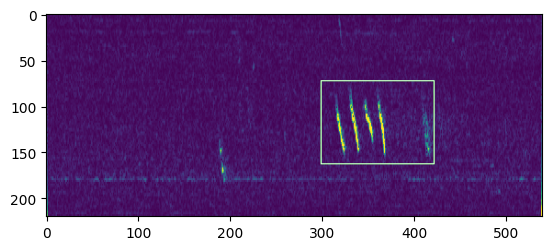

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


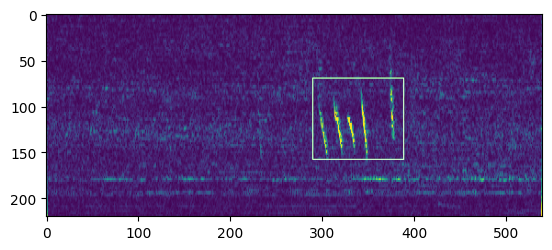

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


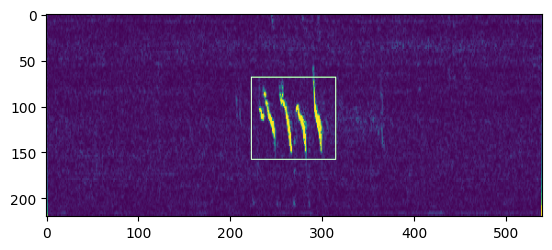

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


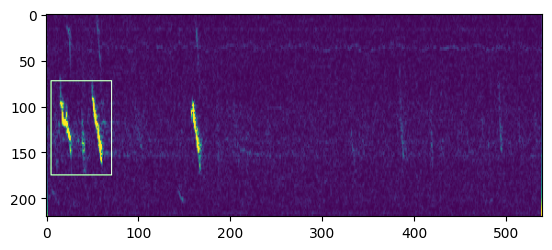

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


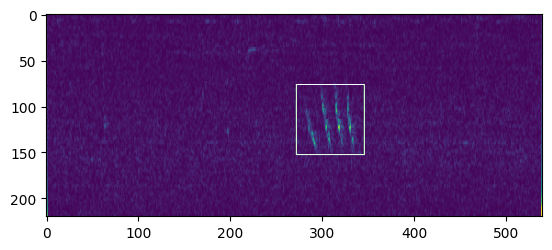

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


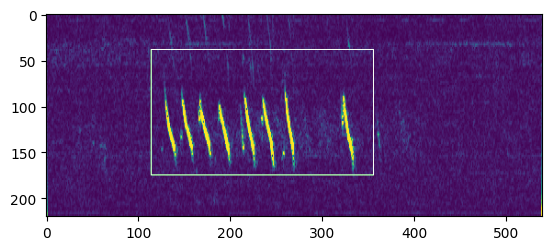

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


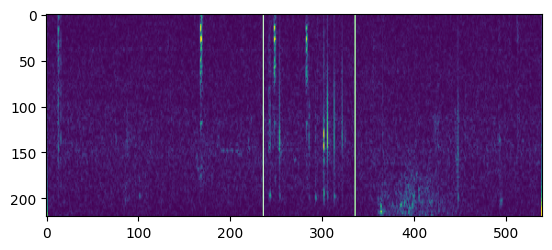

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


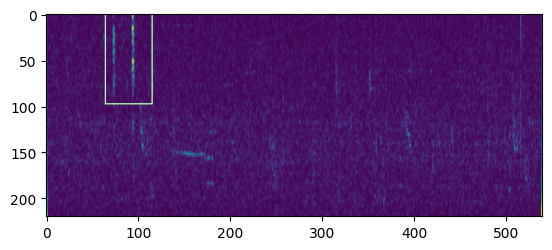

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


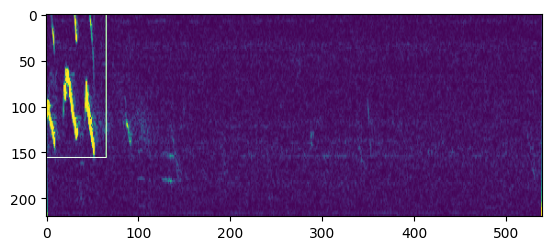

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


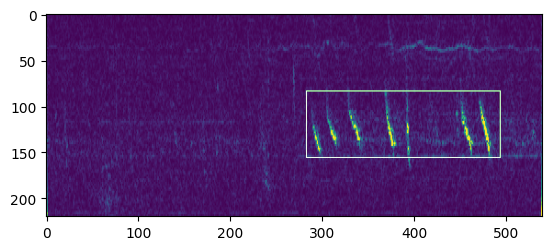

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


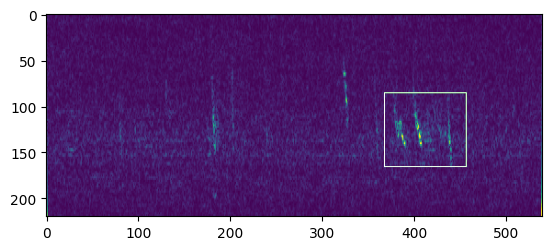

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


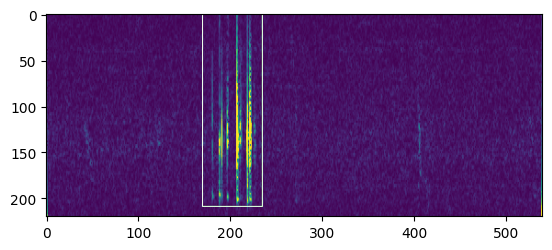

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


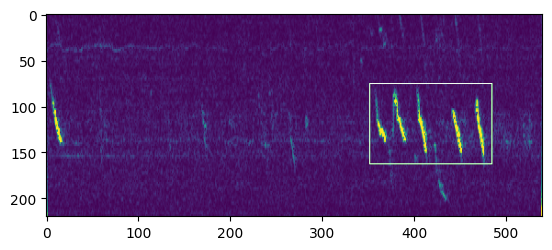

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


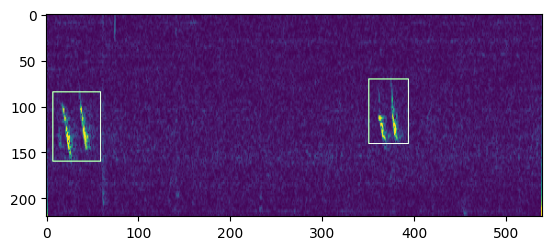

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


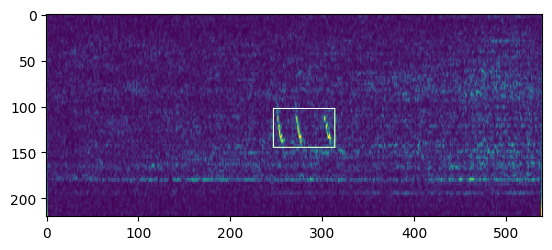

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


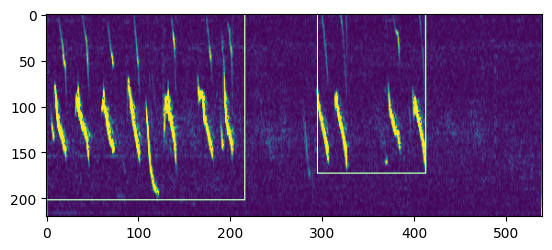

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


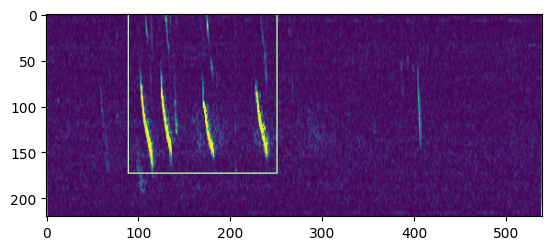

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


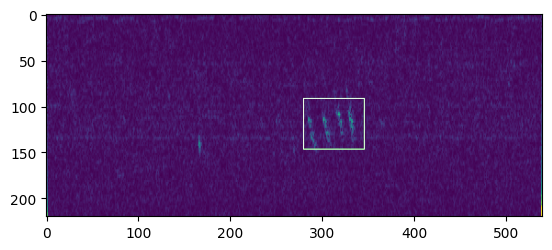

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


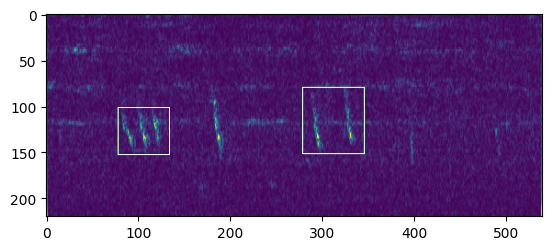

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


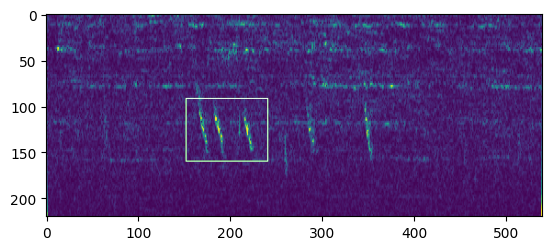

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


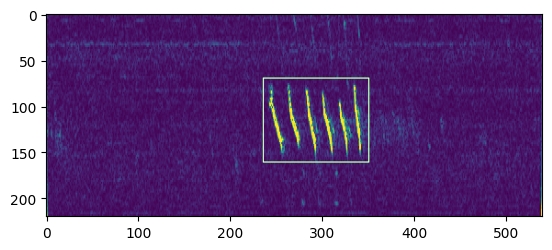

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


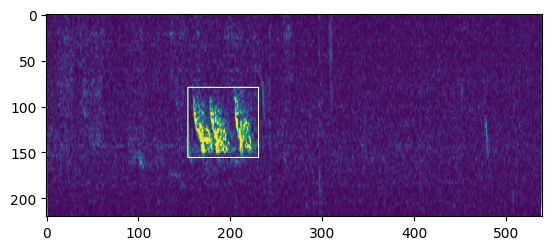

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


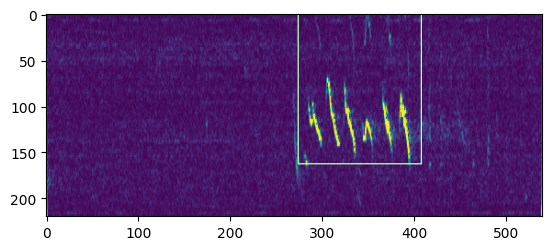

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


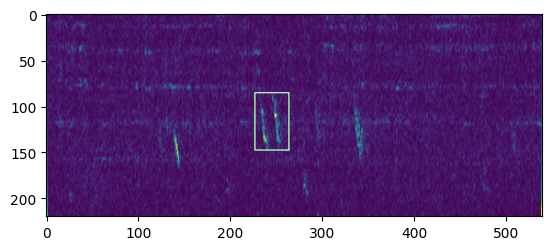

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


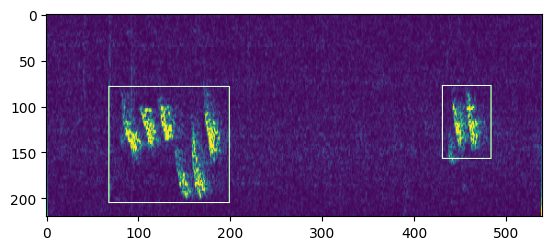

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


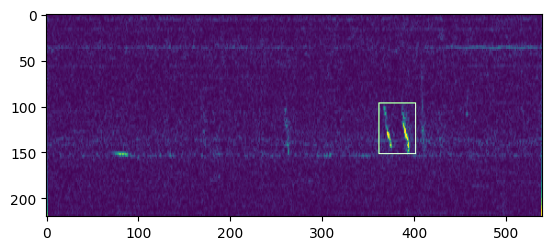

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


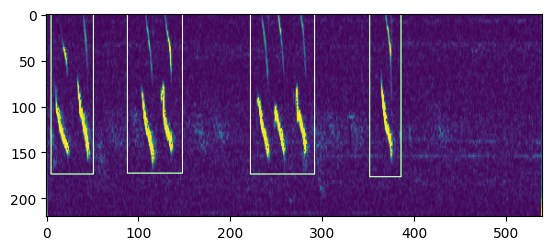

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


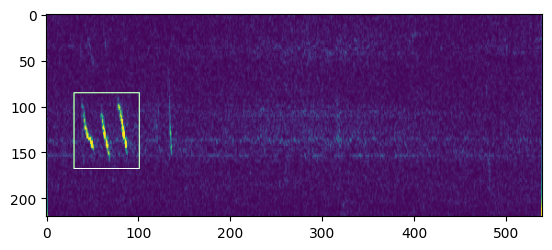

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


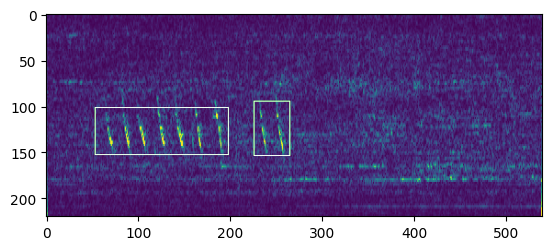

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


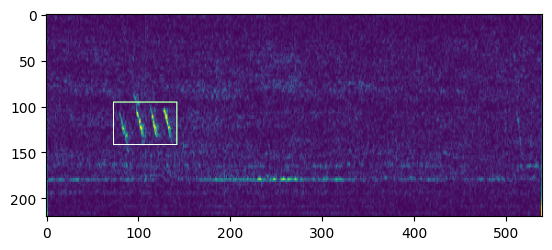

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


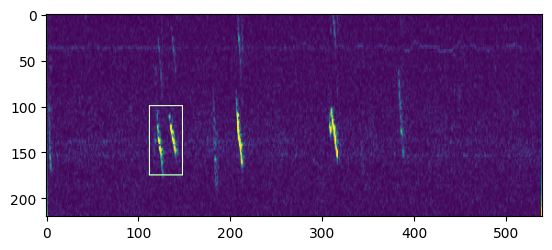

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


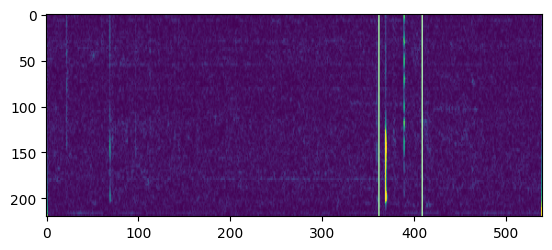

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


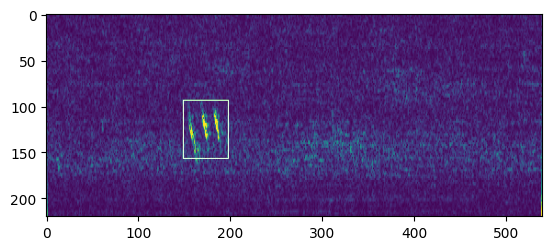

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


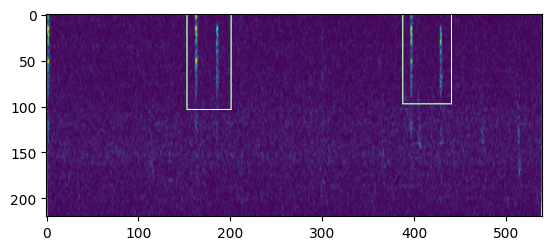

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


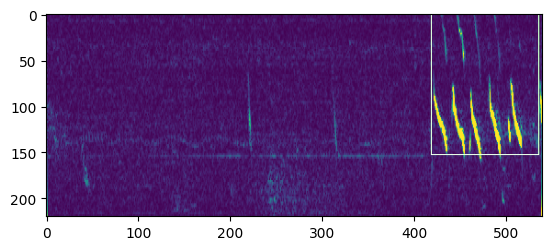

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


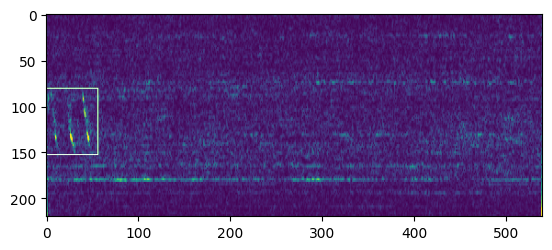

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


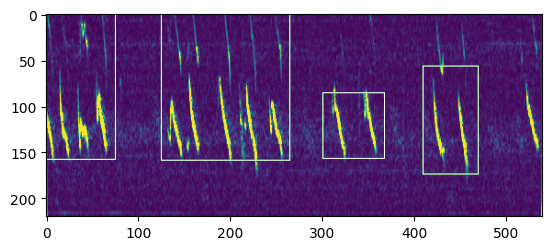

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


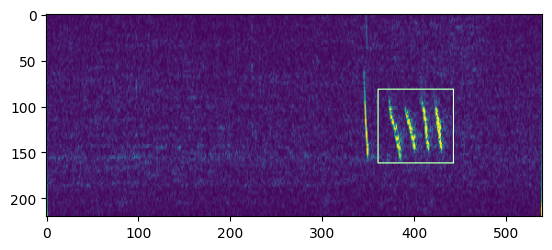

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


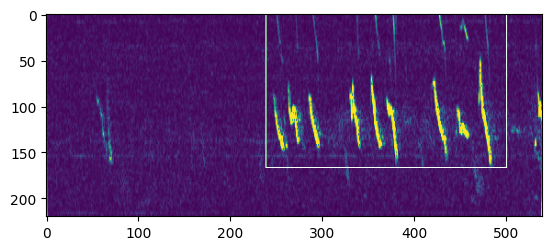

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


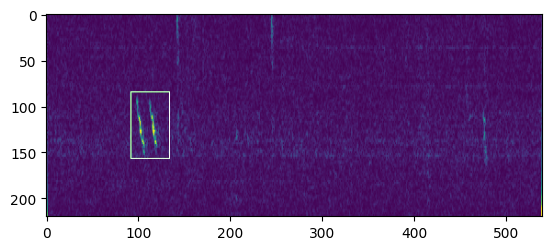

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


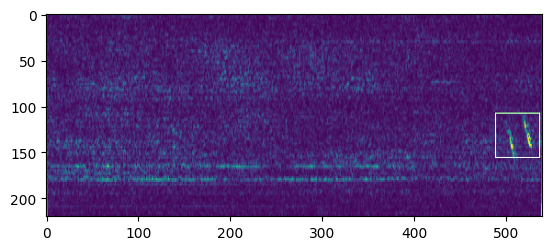

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


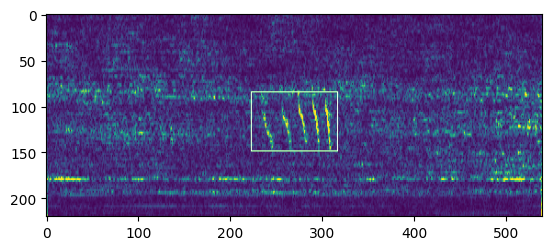

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


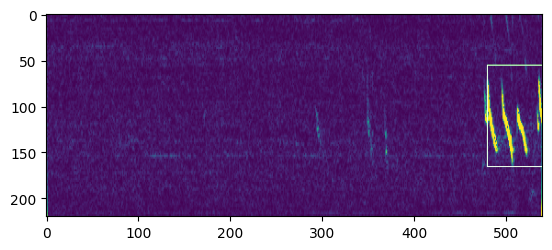

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


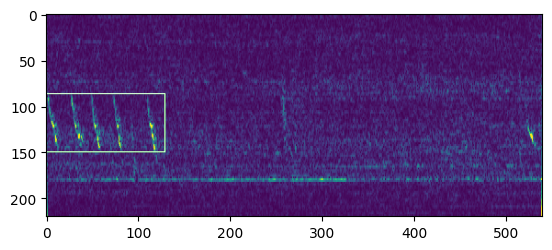

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


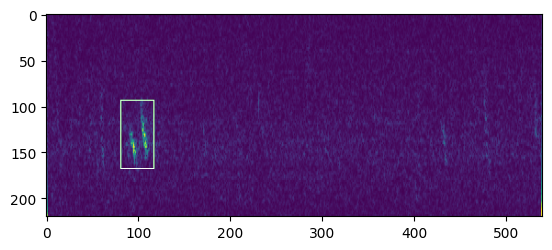

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


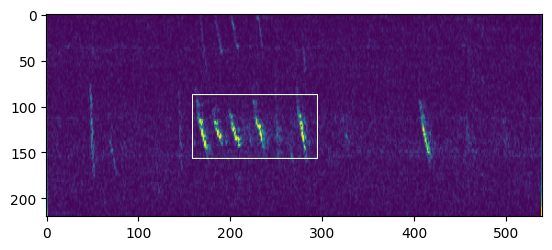

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


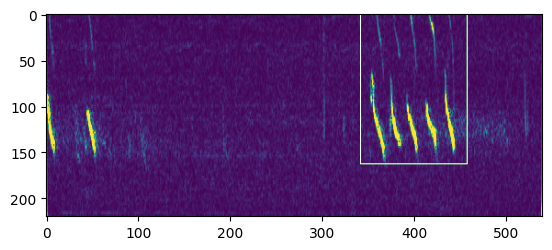

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


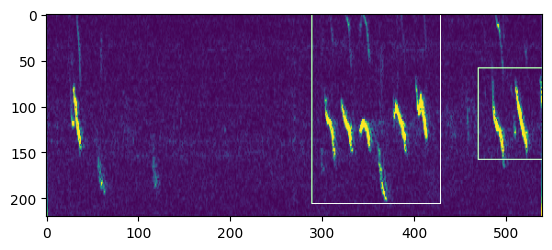

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


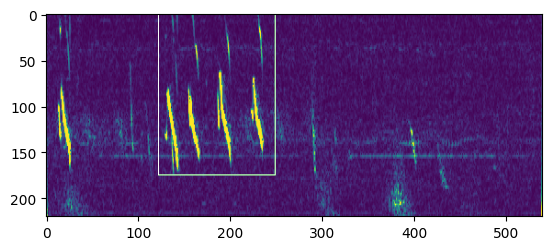

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


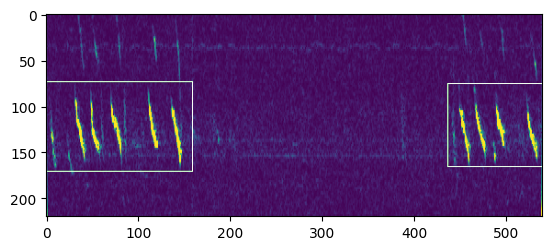

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


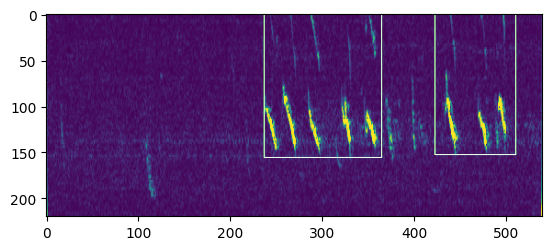

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


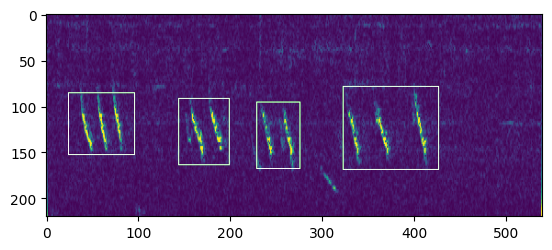

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


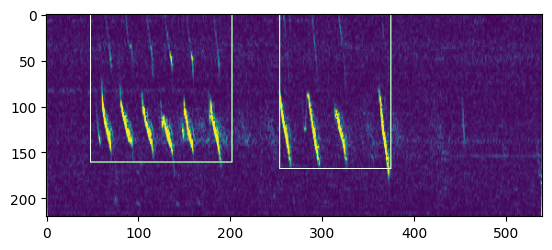

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


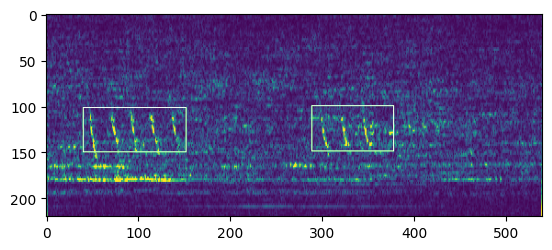

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


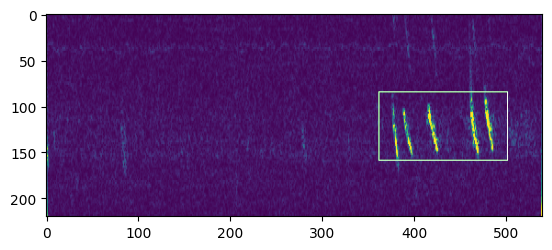

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


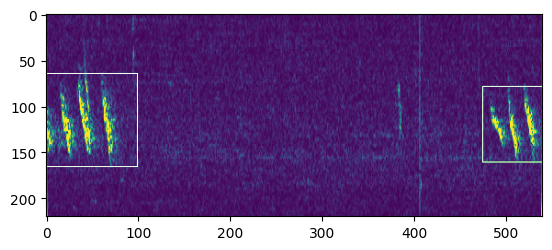

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


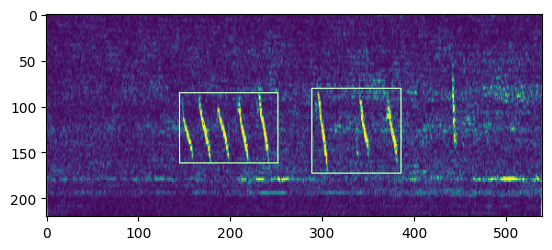

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


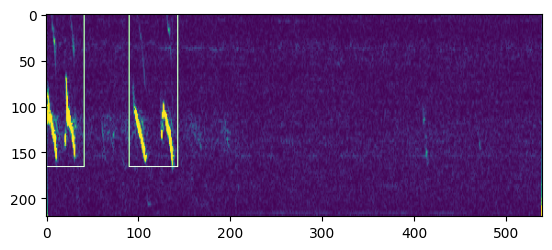

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


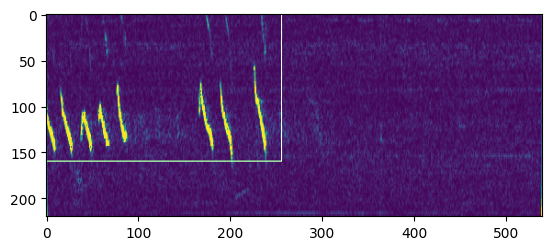

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


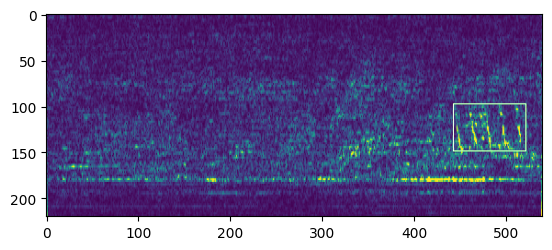

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


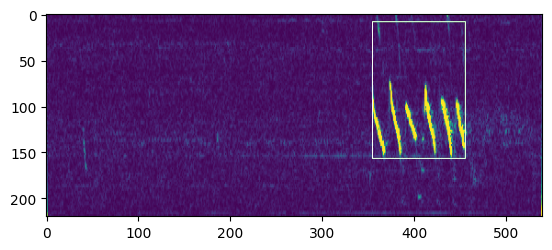

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


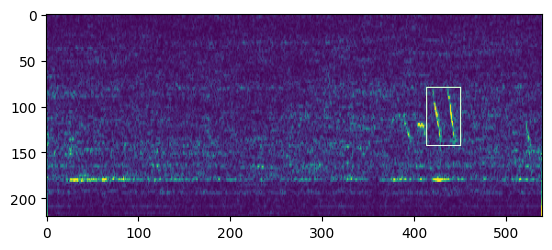

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


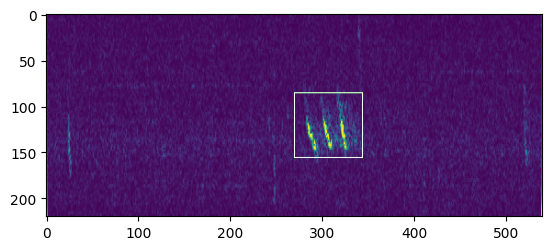

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


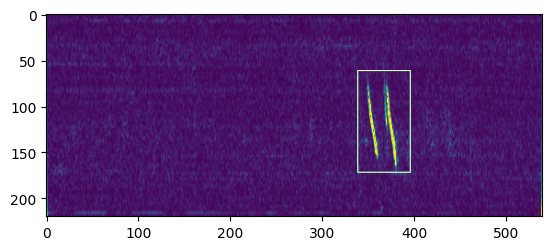

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


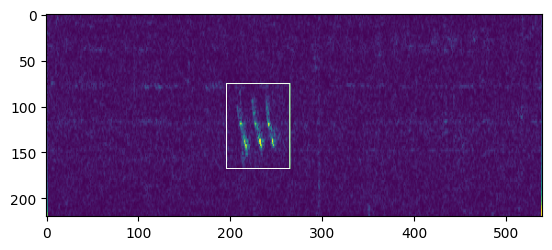

In [12]:
for e, fn in enumerate(filenames):
    try:
        image = plt.imread(os.path.join(images_path,fn))
        an = annotation_pd[annotation_pd['image_name'] == fn].to_numpy()
        
        gtvalues=[]
        for row in an:
            x1 = int(row[1])
            y1 = int(row[2])
            x2 = int(row[1]) + int(row[3])
            y2 = int(row[2]) + int(row[4])
            gtvalues.append({"x1":x1,"x2":x2,"y1":y1,"y2":y2})
            
            x, y, w, h = row[1:5]
            cv2.rectangle(image, (x, y), (x+w, y+h), (0, 255, 0), 1, cv2.LINE_AA)
        plt.imshow(image)
        plt.show()
    
    except:
        pass

In [85]:
train_images = []
train_labels = []

In [86]:
for e, fn in tqdm(enumerate(filenames)):
    try:
        image = plt.imread(os.path.join(images_path,fn))
        an = annotation_pd[annotation_pd['image_name'] == fn].to_numpy()
        
        gtvalues=[]
        for row in an:
            x1 = int(row[1])
            y1 = int(row[2])
            x2 = int(row[1]) + int(row[3])
            y2 = int(row[2]) + int(row[4])
            gtvalues.append({"x1":x1,"x2":x2,"y1":y1,"y2":y2})
            
            #x, y, w, h = row[1:5]
            #cv2.rectangle(image, (x, y), (x+w, y+h), (0, 255, 0), 1, cv2.LINE_AA)
        #plt.imshow(image)
        #plt.show()
        ss.setBaseImage(image)
        ss.switchToSelectiveSearchFast()
        ssresults = ss.process()
        imout = image.copy()
        counter = 0
        falsecounter = 0
        flag = 0
        fflag = 0
        bflag = 0
        for e,result in enumerate(ssresults):
                if e < 2000 and flag == 0:
                    for gtval in gtvalues:
                        x,y,w,h = result
                        iou = get_iou(gtval,{"x1":x,"x2":x+w,"y1":y,"y2":y+h})
                        iou_max = max([get_iou(a,{"x1":x,"x2":x+w,"y1":y,"y2":y+h}) for a in gtvalues])
                        if counter < 30:
                            if iou > 0.5:
                                timage = imout[y:y+h,x:x+w]
                                resized = cv2.resize(timage, (224,224), interpolation = cv2.INTER_AREA)
                                train_images.append(resized)
                                train_labels.append(1)
                                counter += 1
                        else :
                            fflag =1
                        if (falsecounter <30) and (falsecounter < counter*1.5):
                            if iou_max < 0.01:
                                timage = imout[y:y+h,x:x+w]
                                resized = cv2.resize(timage, (224,224), interpolation = cv2.INTER_AREA)
                                train_images.append(resized)
                                train_labels.append(0)
                                falsecounter += 1
                        else :
                            bflag = 1
                    if fflag == 1 and bflag == 1:
                        print("inside")
                        flag = 1        
        
    
    except:
        pass

0it [00:00, ?it/s]

inside
inside


In [89]:
train_labels = np.array(train_labels)
train_images = np.array(train_images)

In [90]:
print("Augmented Data for RCNN:")
print("Positive Detection Samples: {}".format(np.sum(np.array(train_labels) == 1)))
print("Negative Detection Samples: {}".format(np.sum(np.array(train_labels) == 0)))

Augmented Data for RCNN:
Positive Detection Samples: 491
Negative Detection Samples: 457


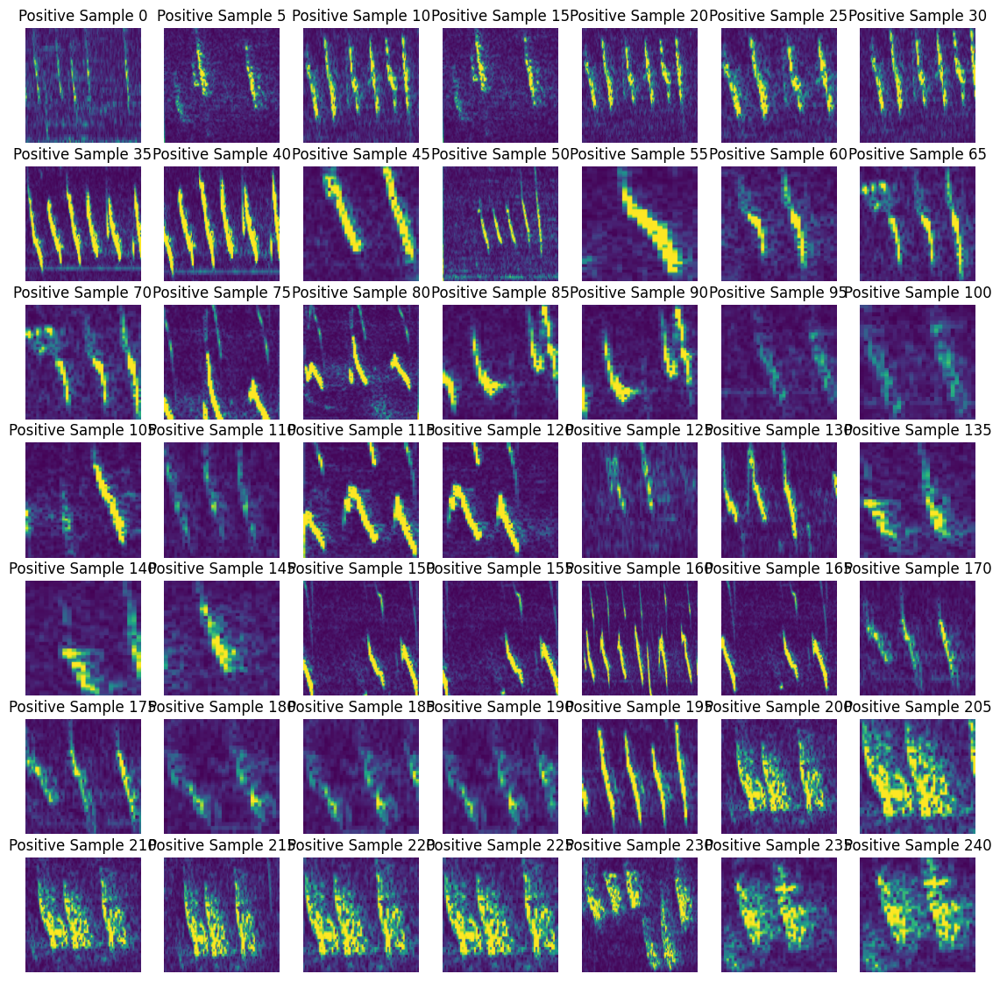

In [102]:
plt.figure(figsize=(14,14))
plt.rcParams['axes.titlelocation'] = 'center'
count = 0
for i, im in enumerate(np.array([train_images[i] for i, x in enumerate(train_labels) if x == 1])):
    if count < 49:
        if i%5 == 0:
            plt.subplot(7, 7, count + 1)
            plt.imshow(im)
            plt.axis('off')
            plt.title("Positive Sample {}".format(i))
            count+=1

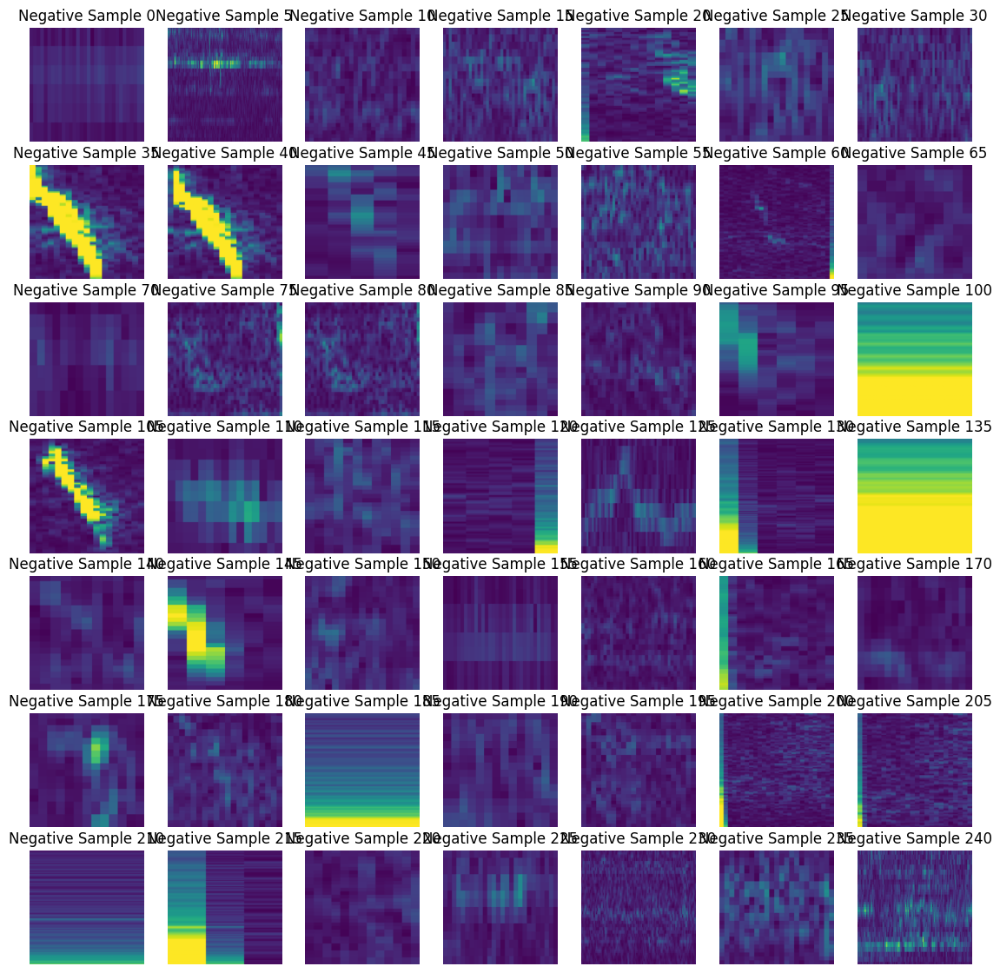

In [103]:
plt.figure(figsize=(14,14))
plt.rcParams['axes.titlelocation'] = 'center'
count = 0
for i, im in enumerate(np.array([train_images[i] for i, x in enumerate(train_labels) if x == 0])):
    if count < 49:
        if i%5 == 0:
            plt.subplot(7, 7, count + 1)
            plt.imshow(im)
            plt.axis('off')
            plt.title("Negative Sample {}".format(i))
            count+=1

In [132]:
X_new = np.array(train_images)[:, :, :, :3]
y_new = np.array(train_labels)

In [133]:
X_new.shape

(948, 224, 224, 3)

In [105]:
from keras.layers import Dense
from keras import Model
from keras import optimizers
from keras.preprocessing.image import ImageDataGenerator
from keras.applications.vgg16 import VGG16

In [142]:
vggmodel = VGG16(weights='imagenet', include_top=True)
vggmodel.summary()

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

In [143]:
for layers in (vggmodel.layers)[:15]:
    print(layers)
    layers.trainable = False

In [144]:
X= vggmodel.layers[-2].output

In [145]:
predictions = Dense(2, activation="softmax")(X)

In [146]:
from tensorflow.keras.optimizers import Adam
opt = Adam(lr=0.0001)

C:\ProgramData\Anaconda3\envs\oceansoundscape2\lib\site-packages\keras\optimizers\optimizer_v2\adam.py:114: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super().__init__(name, **kwargs)


In [147]:
model_final = Model(inputs = [vggmodel.input], outputs = [predictions])

In [148]:
model_final.compile(loss = tf.keras.losses.categorical_crossentropy, optimizer = opt, metrics=["accuracy"])

In [149]:
model_final.summary()


Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0   

In [150]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelBinarizer

In [151]:
class MyLabelBinarizer(LabelBinarizer):
    def transform(self, y):
        Y = super().transform(y)
        if self.y_type_ == 'binary':
            return np.hstack((Y, 1-Y))
        else:
            return Y
    def inverse_transform(self, Y, threshold=None):
        if self.y_type_ == 'binary':
            return super().inverse_transform(Y[:, 0], threshold)
        else:
            return super().inverse_transform(Y, threshold)

In [152]:
lenc = MyLabelBinarizer()
Y =  lenc.fit_transform(y_new)

In [153]:
X_train, X_test , y_train, y_test = train_test_split(X_new,Y,test_size=0.10)
print(X_train.shape,X_test.shape,y_train.shape,y_test.shape)

(853, 224, 224, 3) (95, 224, 224, 3) (853, 2) (95, 2)


In [154]:
trdata = ImageDataGenerator(horizontal_flip=True, vertical_flip=True, rotation_range=90)
traindata = trdata.flow(x=X_train, y=y_train)
tsdata = ImageDataGenerator(horizontal_flip=True, vertical_flip=True, rotation_range=90)
testdata = tsdata.flow(x=X_test, y=y_test)

In [155]:
from keras.callbacks import ModelCheckpoint, EarlyStopping


In [156]:
checkpoint = ModelCheckpoint("ieeercnn_vgg16_1.h5", monitor='val_loss', verbose=1, save_best_only=True, save_weights_only=False, mode='auto', period=1)
early = EarlyStopping(monitor='val_loss', min_delta=0, patience=100, verbose=1, mode='auto')

In [157]:
model = hist = model_final.fit_generator(generator= traindata, steps_per_epoch= 10, epochs= 20, validation_data= testdata, validation_steps=2, callbacks=[checkpoint,early])


C:\Users\vikas\AppData\Local\Temp\ipykernel_5328\599707176.py:1: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  model = hist = model_final.fit_generator(generator= traindata, steps_per_epoch= 10, epochs= 20, validation_data= testdata, validation_steps=2, callbacks=[checkpoint,early])


Epoch 1/20
10/10 [==============================] - ETA: 0s - loss: 3.5031 - accuracy: 0.5094
Epoch 1: val_loss improved from inf to 0.62974, saving model to ieeercnn_vgg16_1.h5
10/10 [==============================] - 7s 696ms/step - loss: 3.5031 - accuracy: 0.5094 - val_loss: 0.6297 - val_accuracy: 0.5156
Epoch 2/20
10/10 [==============================] - ETA: 0s - loss: 0.3357 - accuracy: 0.8594
Epoch 2: val_loss improved from 0.62974 to 0.14558, saving model to ieeercnn_vgg16_1.h5
10/10 [==============================] - 6s 595ms/step - loss: 0.3357 - accuracy: 0.8594 - val_loss: 0.1456 - val_accuracy: 0.9531
Epoch 3/20
10/10 [==============================] - ETA: 0s - loss: 0.2144 - accuracy: 0.9375
Epoch 3: val_loss improved from 0.14558 to 0.11286, saving model to ieeercnn_vgg16_1.h5
10/10 [==============================] - 6s 586ms/step - loss: 0.2144 - accuracy: 0.9375 - val_loss: 0.1129 - val_accuracy: 0.9688
Epoch 4/20
10/10 [==============================] - ETA: 0s - los

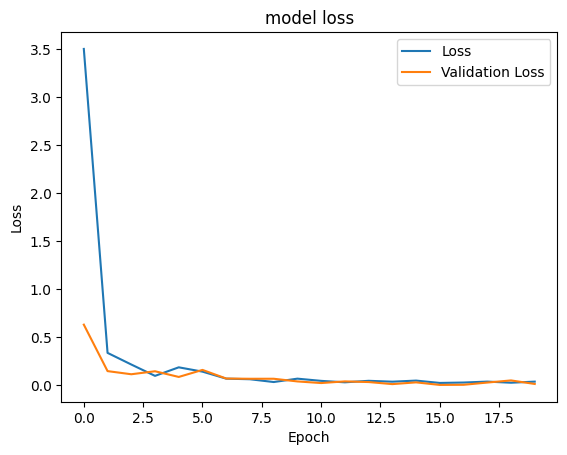

<Figure size 640x480 with 0 Axes>

In [158]:
# plt.plot(hist.history["acc"])
# plt.plot(hist.history['val_acc'])
plt.plot(hist.history['loss'])
plt.plot(hist.history['val_loss'])
plt.title("model loss")
plt.ylabel("Loss")
plt.xlabel("Epoch")
plt.legend(["Loss","Validation Loss"])
plt.show()
plt.savefig('chart loss.png')

1/1 [==============================] - 0s 24ms/step
Positive Detection


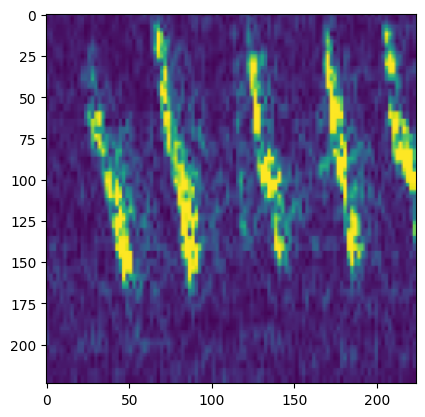

In [167]:
im = X_test[0]
plt.imshow(im)
img = np.expand_dims(im, axis=0)
out= model_final.predict(img)


1.0

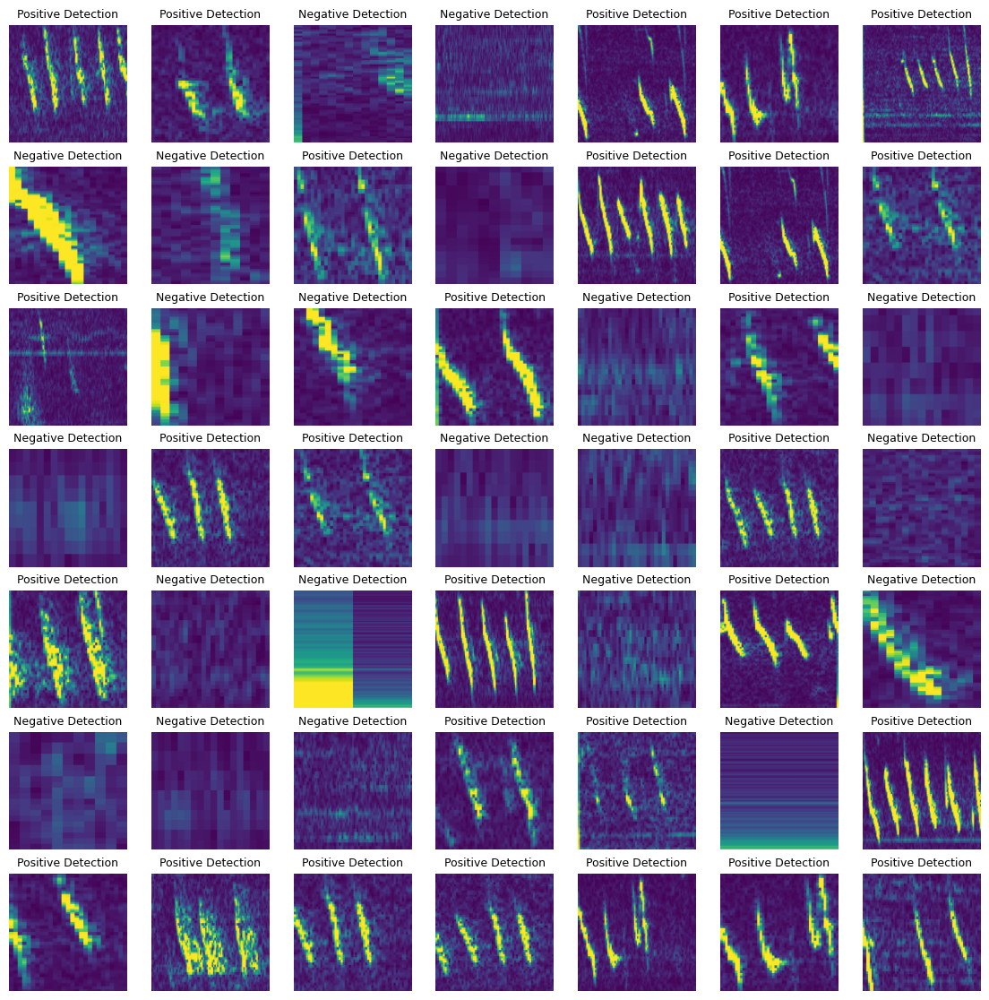

In [184]:
plt.figure(figsize=(14,14))
plt.rcParams['axes.titlelocation'] = 'center'
count = 0
for i, im in enumerate(X_test):
    if count < 49:
            plt.subplot(7, 7, count + 1)
            plt.imshow(im)
            img = np.expand_dims(im, axis=0)
            out= model_final.predict(img, verbose=0)
            plt.axis('off')
            if out[0][0] > out[0][1]:
                plt.title("Positive Detection",fontsize=9)
            else:
                plt.title("Negative Detection",fontsize=9)
            count+=1